## Intro

In our last episode, we explored the trips taken in February of 2021.

In this post, let's carry out a deeper analysis of Mapo county in specific. 

## Data

In [9]:
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium import plugins
import missingno as mnso
import warnings
warnings.filterwarnings('ignore')
mpl.rcParams['axes.unicode_minus'] = False
# plt.rcParams["font.family"] = 'NanumGothic'
plt.rc('font', family='NanumGothic')

In [10]:
import matplotlib
import matplotlib.font_manager as fm
fm.get_fontconfig_fonts()
font_location = 'C:/Users/82104/Desktop/Side Projects/Seoul_Bike/NanumGothic.ttf'
font_name = fm.FontProperties(fname=font_location).get_name()
matplotlib.pyplot.rc('font', family=font_name)


%matplotlib inline

In [11]:
mpl.rcParams['axes.unicode_minus'] = False
plt.rcParams["font.family"] = 'NanumGothic'

In [12]:
print(mpl.rcParams['font.family'])
print(plt.rcParams['font.family'])

['NanumGothic']
['NanumGothic']


In [13]:
import json
geo_path = 'C:/Users/82104/Desktop/Side Projects/Seoul_Bike/New_Seoul_Bike/Data/Station/seoul_municipalities_geo_simple.json'
geo_str = json.load(open(geo_path, encoding='utf-8'))

In [14]:
trips = pd.read_csv('C:/Users/82104/Desktop/Side Projects/Seoul_Bike/New_Seoul_Bike/Data/Trips/공공자전거 대여이력 정보_2021.02.csv', encoding = 'euc-kr')
trips.head()

,start_time,start_station_id,start_station_name,end_time,end_station_id,end_station_name,duration,distance
0,2/1/2021 0:00,1514,강북구청 사거리 버스정류소 앞,2/1/2021 0:03,1554,번동사거리,2.0,736.02
1,2/1/2021 0:01,1977,천왕역 1번 출입구 앞,2/1/2021 0:04,1981,천왕이펜하우스5단지 앞,3.0,856.09
2,2/1/2021 0:02,1358,정릉도서관 앞,2/1/2021 0:05,1360,정릉역,2.0,397.92
3,2/1/2021 0:00,1211,방이삼거리,2/1/2021 0:05,2639,석촌역 8번출구,4.0,1015.50
4,2/1/2021 0:01,1721,창동역 2번출구,2/1/2021 0:06,1708,보건소사거리(다비치안경창동점),4.0,0.00


In [15]:
trips['start_time'] = pd.to_datetime(trips['start_time'])
trips['end_time'] = pd.to_datetime(trips['end_time'], errors = 'coerce')

In [16]:
trips.shape

(1048575, 8)

In [17]:
trips = trips.dropna()

In [18]:
trips.shape

(1048558, 8)

In [19]:
trips['start_hour'] = trips['start_time'].dt.hour
trips['start_day'] = trips['start_time'].dt.day
trips['start_dayofweek'] = trips['start_time'].dt.dayofweek
trips['end_hour'] = trips['end_time'].dt.hour

In [20]:
trips.tail()

,start_time,start_station_id,start_station_name,end_time,end_station_id,end_station_name,duration,distance,start_hour,start_day,start_dayofweek,end_hour
1048570,2021-02-26 15:21:00,1108,공항시장역 2번출구 뒤,2021-02-26 15:36:00,1153,"발산역 1번, 9번 인근 대여소",15.0,2524.64,15,26,4,15
1048571,2021-02-26 15:29:00,2610,여흥레이크빌 앞 (석촌호수 까페거리),2021-02-26 15:36:00,1210,롯데월드타워(잠실역2번출구 쪽),7.0,1086.82,15,26,4,15
1048572,2021-02-26 14:50:00,2000,신도림4차 e편한세상 아파트 1109동 앞,2021-02-26 15:36:00,3789,염창나들목,46.0,6310.07,14,26,4,15
1048573,2021-02-26 14:41:00,2648,헬리오시티 112동 앞,2021-02-26 15:36:00,2625,가락1동 주민센터,54.0,11315.31,14,26,4,15
1048574,2021-02-26 15:29:00,1946,구로역 광장,2021-02-26 15:36:00,1956,도야미리숯불갈비 앞,7.0,1063.86,15,26,4,15


In [21]:
trips.dtypes

start_time            datetime64[ns]
start_station_id               int64
start_station_name            object
end_time              datetime64[ns]
end_station_id                object
end_station_name              object
duration                     float64
distance                     float64
start_hour                     int64
start_day                      int64
start_dayofweek                int64
end_hour                       int64
dtype: object

<AxesSubplot:>

findfont: Font family ['NanumGothic'] not found. Falling back to DejaVu Sans.
findfont: Font family ['NanumGothic'] not found. Falling back to DejaVu Sans.
findfont: Font family ['NanumGothic'] not found. Falling back to DejaVu Sans.


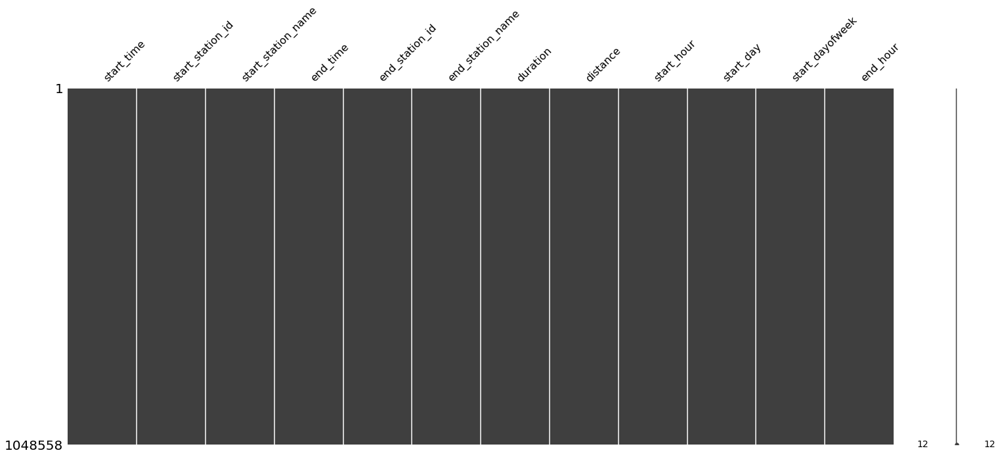

In [22]:
import missingno as msno
msno.matrix(trips)

In [23]:
s_eng = pd.read_csv('C:/Users/82104/Desktop/Side Projects/Seoul_Bike/New_Seoul_Bike/Data/Station/Seoul_Distict_ID_English.csv', encoding = 'euc-kr')
s_eng = s_eng.drop(columns=['county_id','lat','long'])
s_kr = pd.read_csv('C:/Users/82104/Desktop/Side Projects/Seoul_Bike/New_Seoul_Bike/Data/Station/station_df_facilities_info.csv', encoding = 'cp949')
station = pd.merge(s_eng, s_kr, how = "inner", on = "county")
station.head()

,county,county_eng,station_id,station_name,lat,long,station_install_date,capa,rent_type,dong,bus_min_dist,num_bus_within_150m,subway_500m,culture_500m,school_500m,market_500m,tour_500m
0,도봉구,Dobong,1702,녹천역 1번출구 앞,37.646172,127.050560,5/8/2017,10,LCD,번1동,65.854878,1,1,0,5,0,0
1,도봉구,Dobong,1703,도봉산광역환승센터앞,37.689720,127.045197,5/11/2017,15,LCD,창1동,62.015531,6,2,0,1,0,1
2,도봉구,Dobong,1705,도봉구청 정문앞,37.669224,127.046516,5/8/2017,8,LCD,도봉1동,30.788507,5,1,1,2,0,1
3,도봉구,Dobong,1706,기업은행 앞,37.665665,127.042671,6/27/2017,10,LCD,방학1동,33.531927,4,1,1,1,0,3
4,도봉구,Dobong,1707,도봉구민회관,37.654461,127.038513,5/8/2017,15,LCD,방학1동,31.866318,5,0,6,5,0,2


In [24]:
station.shape

(2154, 17)

In [25]:
station = station.astype({
    "county": "category",
    "county_eng": "category",
    "station_id": "category",
    "lat": "category",
    "long": "category"
})

Let's join Rent station first

In [26]:
trips.shape

(1048558, 12)

In [27]:
station.head()

,county,county_eng,station_id,station_name,lat,long,station_install_date,capa,rent_type,dong,bus_min_dist,num_bus_within_150m,subway_500m,culture_500m,school_500m,market_500m,tour_500m
0,도봉구,Dobong,1702,녹천역 1번출구 앞,37.646172,127.050560,5/8/2017,10,LCD,번1동,65.854878,1,1,0,5,0,0
1,도봉구,Dobong,1703,도봉산광역환승센터앞,37.689720,127.045197,5/11/2017,15,LCD,창1동,62.015531,6,2,0,1,0,1
2,도봉구,Dobong,1705,도봉구청 정문앞,37.669224,127.046516,5/8/2017,8,LCD,도봉1동,30.788507,5,1,1,2,0,1
3,도봉구,Dobong,1706,기업은행 앞,37.665665,127.042671,6/27/2017,10,LCD,방학1동,33.531927,4,1,1,1,0,3
4,도봉구,Dobong,1707,도봉구민회관,37.654461,127.038513,5/8/2017,15,LCD,방학1동,31.866318,5,0,6,5,0,2


In [28]:
before_merged = len(trips)
df = pd.merge(trips, station[['county','county_eng','station_id','lat','long']],
              left_on="start_station_id",
              right_on="station_id").drop(columns='station_id')
df.head()

,start_time,start_station_id,start_station_name,end_time,end_station_id,end_station_name,duration,distance,start_hour,start_day,start_dayofweek,end_hour,county,county_eng,lat,long
0,2021-02-01 00:00:00,1514,강북구청 사거리 버스정류소 앞,2021-02-01 00:03:00,1554,번동사거리,2.0,736.02,0,1,0,0,강북구,Gangbuk,37.638805,127.028358
1,2021-02-01 00:01:00,1514,강북구청 사거리 버스정류소 앞,2021-02-01 00:11:00,1536,번동 두산위브 101동 옆,9.0,597.75,0,1,0,0,강북구,Gangbuk,37.638805,127.028358
2,2021-02-01 00:51:00,1514,강북구청 사거리 버스정류소 앞,2021-02-01 00:53:00,1552,강북구청사거리(던킨도너츠 앞),1.0,140.00,0,1,0,0,강북구,Gangbuk,37.638805,127.028358
3,2021-02-01 09:34:00,1514,강북구청 사거리 버스정류소 앞,2021-02-01 09:36:00,1569,수유역2번출구,2.0,0.00,9,1,0,9,강북구,Gangbuk,37.638805,127.028358
4,2021-02-01 09:39:00,1514,강북구청 사거리 버스정류소 앞,2021-02-01 10:00:00,1514,강북구청 사거리 버스정류소 앞,21.0,2505.19,9,1,0,10,강북구,Gangbuk,37.638805,127.028358


In [29]:
df.shape

(1035715, 16)

Now let's join Return station

In [30]:
df = pd.merge(df, station[['county','county_eng','station_id','lat','long']], 
              left_on="end_station_id", 
              right_on="station_id").drop(columns='station_id')
df.head()

,start_time,start_station_id,start_station_name,end_time,end_station_id,end_station_name,duration,distance,start_hour,start_day,start_dayofweek,end_hour,county_x,county_eng_x,lat_x,long_x,county_y,county_eng_y,lat_y,long_y
0,2021-02-01 00:00:00,1514,강북구청 사거리 버스정류소 앞,2021-02-01 00:03:00,1554,번동사거리,2.0,736.02,0,1,0,0,강북구,Gangbuk,37.638805,127.028358,강북구,Gangbuk,37.635391,127.034554
1,2021-02-01 18:01:00,1514,강북구청 사거리 버스정류소 앞,2021-02-01 18:08:00,1554,번동사거리,7.0,779.26,18,1,0,18,강북구,Gangbuk,37.638805,127.028358,강북구,Gangbuk,37.635391,127.034554
2,2021-02-01 20:21:00,1514,강북구청 사거리 버스정류소 앞,2021-02-01 20:27:00,1554,번동사거리,5.0,0.00,20,1,0,20,강북구,Gangbuk,37.638805,127.028358,강북구,Gangbuk,37.635391,127.034554
3,2021-02-01 20:32:00,1514,강북구청 사거리 버스정류소 앞,2021-02-01 20:38:00,1554,번동사거리,5.0,736.02,20,1,0,20,강북구,Gangbuk,37.638805,127.028358,강북구,Gangbuk,37.635391,127.034554
4,2021-02-03 00:12:00,1514,강북구청 사거리 버스정류소 앞,2021-02-03 00:14:00,1554,번동사거리,2.0,628.99,0,3,2,0,강북구,Gangbuk,37.638805,127.028358,강북구,Gangbuk,37.635391,127.034554


In [31]:
print(df.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 578407 entries, 0 to 578406
Data columns (total 20 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   start_time          578407 non-null  datetime64[ns]
 1   start_station_id    578407 non-null  object        
 2   start_station_name  578407 non-null  object        
 3   end_time            578407 non-null  datetime64[ns]
 4   end_station_id      578407 non-null  object        
 5   end_station_name    578407 non-null  object        
 6   duration            578407 non-null  float64       
 7   distance            578407 non-null  float64       
 8   start_hour          578407 non-null  int64         
 9   start_day           578407 non-null  int64         
 10  start_dayofweek     578407 non-null  int64         
 11  end_hour            578407 non-null  int64         
 12  county_x            578407 non-null  category      
 13  county_eng_x        578407 no

In [32]:
df.shape

(578407, 20)

In [33]:
mapo = df[(df['county_eng_x'] == 'Mapo') | (df['county_eng_y'] == 'Mapo')]
print(mapo.shape)
mapo.head()

(44811, 20)


,start_time,start_station_id,start_station_name,end_time,end_station_id,end_station_name,duration,distance,start_hour,start_day,start_dayofweek,end_hour,county_x,county_eng_x,lat_x,long_x,county_y,county_eng_y,lat_y,long_y
5342,2021-02-13 15:16:00,114,홍대입구역 8번출구 앞,2021-02-13 17:17:00,322,명동성당 앞,120.0,11989.94,15,13,5,17,마포구,Mapo,37.557060,126.924423,중구,Jung,37.564476,126.986969
12612,2021-02-01 17:43:00,112,극동방송국 앞,2021-02-01 18:41:00,3600,사근빗물펌프장 건너편,57.0,15975.13,17,1,0,18,마포구,Mapo,37.549202,126.923203,성동구,Seongdong,37.560980,127.049300
12679,2021-02-02 14:10:00,118,광흥창역 2번출구 앞,2021-02-02 15:13:00,3600,사근빗물펌프장 건너편,62.0,15612.86,14,2,1,15,마포구,Mapo,37.547733,126.931763,성동구,Seongdong,37.560980,127.049300
18645,2021-02-20 17:43:00,495,염리초등학교 앞,2021-02-20 19:22:00,1382,래미안월곡아파트 입구,98.0,19559.57,17,20,5,19,마포구,Mapo,37.542431,126.946999,성북구,Seongbuk,37.610440,127.036900
19013,2021-02-13 13:58:00,147,마포역 4번출구 뒤,2021-02-13 15:21:00,1684,태릉입구역 5번출구,82.0,22454.48,13,13,5,15,마포구,Mapo,37.539272,126.945915,노원구,Nowon,37.618320,127.075630


## 1. # of Rents

### 1.1. # of Rents by Hour

In [34]:
def draw_usage(df, region):
    
    fig, axes = plt.subplots(1, 2, figsize=(24, 5))
    for i, dayofweek in enumerate(["Weekday", "Weekend"]):
        if dayofweek == "Weekday":
            _dayofweek = set(range(0,5))
        elif dayofweek == "Weekend":
            _dayofweek = set(range(5,7))
        
        by_hour_rental = df[(df['start_dayofweek'].isin(_dayofweek)) & (df['county_eng_x'] == region)].groupby('start_hour').size() / len(_dayofweek)
        by_hour_return = df[(df['start_dayofweek'].isin(_dayofweek)) & (df['county_eng_y'] == region)].groupby('end_hour').size() / len(_dayofweek)
        by_hour = pd.DataFrame(data={
            "Rent": by_hour_rental,
            "Return": by_hour_return
        }).plot(style='.-', rot=0, title="%s, # of Rents by Hour (Rent, Return)" %dayofweek, ax=axes[i])
        plt.sca(axes[i])
        plt.xticks(range(0, 24, 1))
        plt.xlabel("Hour")
        plt.box(False)
        plt.legend(frameon=False)
    plt.show()

findfont: Font family ['NanumGothic'] not found. Falling back to DejaVu Sans.
findfont: Font family ['NanumGothic'] not found. Falling back to DejaVu Sans.


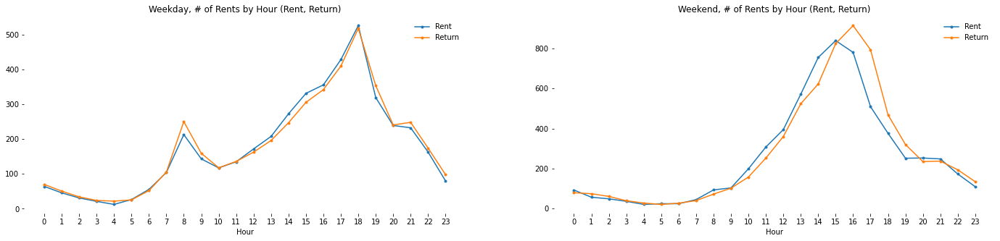

In [35]:
draw_usage(mapo, "Mapo")

- During weekdays, 
    - Rents/Returns hit the peak at 8am and 6pm which is similar to the pattern of Seoul as a whole.  
    - Given that there are more returns at 8am and more rents between 16pm and 18pm, we can infer that many users are commuting to Mapo county from other counties.
    
- During weekends,
    - \# of Rents keeps rising early afternoon (until 3pm)
    - \# of Returns shows a similar pattern with 1 hour lag and hits the peak at 4pm
    - The pattern may be different throughout the year depending on the temperature and sunset time.

### 1.2 Distance & Trip Duration by Hour

In [36]:
def draw_dist_time(df, region):
    
    fig, axes = plt.subplots(1, 2, figsize=(24, 5))
    
    for i, (var, unit) in enumerate(zip(["distance", "duration"], ["m", "Minute"])):
        by_hour_rental_weekday = df[(df['start_dayofweek'].isin(set(range(0,5)))) & (df['county_eng_x'] == region)].groupby('start_hour')[var].median()
        by_hour_rental_weekend = df[(df['start_dayofweek'].isin(set(range(5,7)))) & (df['county_eng_x'] == region)].groupby('start_hour')[var].median()
        by_hour = pd.DataFrame(data={
            "Weekday": by_hour_rental_weekday,
            "Weekend": by_hour_rental_weekend
        }).plot(style='.-', rot=0, title="Median %s by Hour (%s)" %(var, unit), ax=axes[i], color=["C3", "C4"])
        plt.sca(axes[i])
        plt.xticks(range(0, 24, 1))
        plt.xlabel("Hour")
        plt.box(False)
        plt.legend(frameon=False)
        
        print("[%s]" %var)
        print("Weekday Median %s: %d%s" %(var, by_hour_rental_weekday.mean(), unit))
        print("Weekend Median %s: %d%s" %(var, by_hour_rental_weekend.mean(), unit))
        
    plt.show()

[distance]
Weekday Median distance: 1809m
Weekend Median distance: 2686m
[duration]
Weekday Median duration: 16Minute
Weekend Median duration: 25Minute


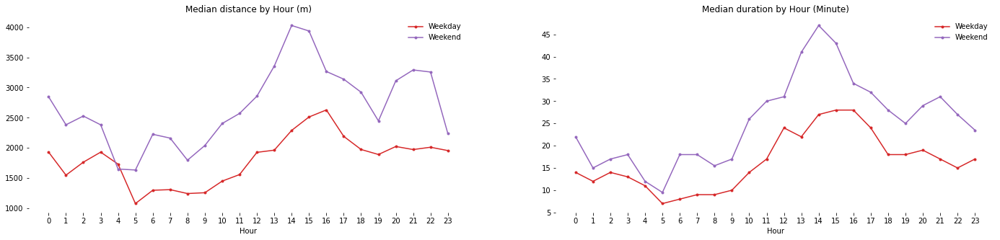

In [37]:
draw_dist_time(mapo, "Mapo")

- The distance and trip duration have similar pattern in both weekdays and weekends
- The overall # of is higher during weekends.
- \# of Rents/Returns is highest between 12pm and 4pm. This might be because that's the warmest time of the day in February.

## 2. User Analysis

In [38]:
users = pd.read_csv('C:/Users/82104/Desktop/Side Projects/Seoul_Bike/New_Seoul_Bike/Data/Trips/공공자전거 이용정보(시간대별)_21.2.csv', 
                    encoding = 'euc-kr')

users.head()

,start_time,start_hour,station_id,start_station_name,sex,age_group,rent_cnt,kcal,CO2,distance,duration
0,2/1/2021,0,1534,북서울 꿈의 숲 동문,NaN,~10s,1.0,136.17,1.23,5290.11,51.0
1,2/1/2021,0,1171,염창동 새마을금고 건너편 (모닝글로리),NaN,~10s,1.0,20.69,0.16,669.97,26.0
2,2/1/2021,0,3421,혜화역 1번출구,NaN,~10s,1.0,2.86,0.03,111.20,0.0
3,2/1/2021,0,791,현대하이페리온,NaN,~10s,1.0,8.2,0.07,318.39,3.0
4,2/1/2021,0,2741,마곡수명산파크5-6단지,NaN,~10s,1.0,66.57,0.63,2711.37,34.0


In [39]:
mapo_users = pd.merge(users, station[['county','county_eng','station_id','lat','long']],
              left_on="station_id",
              right_on="station_id").drop(columns='station_id')
mapo_users = mapo_users[mapo_users['county_eng'] == 'Mapo']
mapo_users.head()

,start_time,start_hour,start_station_name,sex,age_group,rent_cnt,kcal,CO2,distance,duration,county,county_eng,lat,long
19739,2/1/2021,0,성산2교 사거리,NaN,20s,1.0,13.08,0.13,560.00,4.0,마포구,Mapo,37.564697,126.912613
19740,2/1/2021,9,성산2교 사거리,NaN,20s,1.0,32.02,0.25,1078.04,5.0,마포구,Mapo,37.564697,126.912613
19741,2/1/2021,9,성산2교 사거리,F,20s,1.0,63.77,0.62,2683.98,17.0,마포구,Mapo,37.564697,126.912613
19742,2/1/2021,9,성산2교 사거리,M,20s,1.0,85.64,0.77,3327.11,20.0,마포구,Mapo,37.564697,126.912613
19743,2/1/2021,10,성산2교 사거리,F,30s,1.0,92.81,1.11,4782.97,31.0,마포구,Mapo,37.564697,126.912613


### 2.1. Usage Comparison by Sex

In [40]:
sex_colors = ['crimson', 'royalblue']
sex_colors_r = list(reversed(sex_colors))

In [41]:
users['rent_cnt'] = pd.to_numeric(users['rent_cnt'])
mapo_users['rent_cnt'] = pd.to_numeric(mapo_users['rent_cnt'])

In [42]:
users = users[(users['sex'] == "F") | (users['sex'] == "M")]
mapo_users = mapo_users[(mapo_users['sex'] == "F") | (mapo_users['sex'] == "M")]

In [43]:
users.groupby('sex').size()

sex
F    221785
M    366067
dtype: int64

In [44]:
mapo_users.groupby('sex').size()

sex
F    14695
M    21887
dtype: int64

sex
F    240891.0
M    391872.0
Name: rent_cnt, dtype: float64


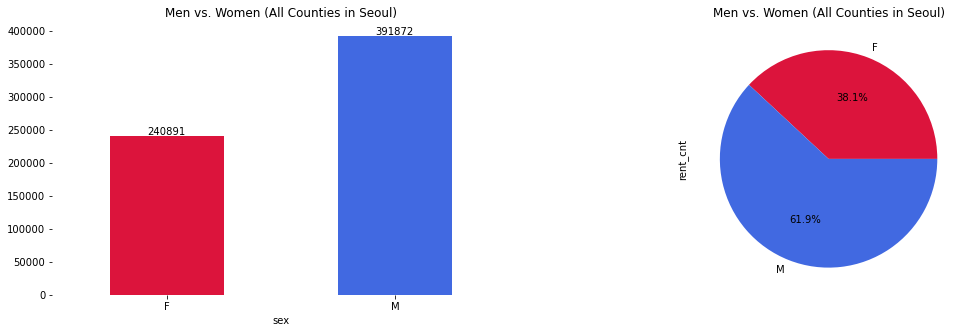

In [45]:
use_per_sex = users.groupby('sex')['rent_cnt'].sum()
print(use_per_sex)

fig, axes = plt.subplots(1, 2, figsize=(18, 5))
ax = use_per_sex.plot(kind='bar', title="Men vs. Women (All Counties in Seoul)", rot=0, ax=axes[0], color=sex_colors)
for p in ax.patches:
    left, bottom, width, height = p.get_bbox().bounds
    ax.annotate("%d"%(height), (left+width/2, height+1000), ha='center')
plt.sca(ax)
plt.box(False)
ax = use_per_sex.div(use_per_sex.sum()).plot(kind='pie', title="Men vs. Women (All Counties in Seoul)", autopct='%.1f%%', ax=axes[1], colors=sex_colors)
plt.sca(ax)
plt.box(False)
plt.show()

sex
F    16478.0
M    23726.0
Name: rent_cnt, dtype: float64


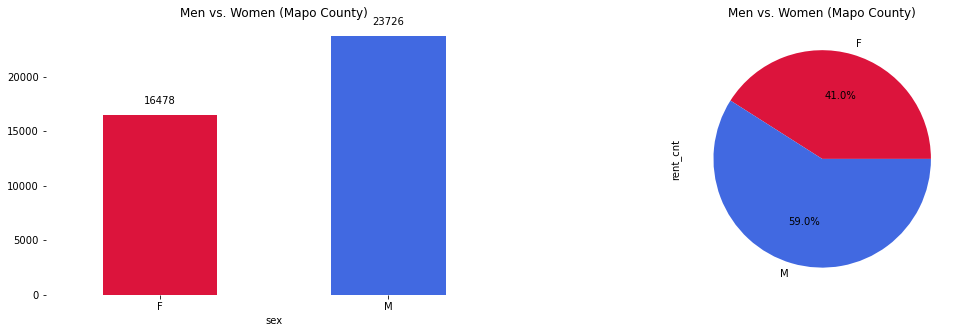

In [46]:
use_per_sex = mapo_users.groupby('sex')['rent_cnt'].sum()
print(use_per_sex)

fig, axes = plt.subplots(1, 2, figsize=(18, 5))
ax = use_per_sex.plot(kind='bar', title="Men vs. Women (Mapo County)", rot=0, ax=axes[0], color=sex_colors)
for p in ax.patches:
    left, bottom, width, height = p.get_bbox().bounds
    ax.annotate("%d"%(height), (left+width/2, height+1000), ha='center')
plt.sca(ax)
plt.box(False)
ax = use_per_sex.div(use_per_sex.sum()).plot(kind='pie', title="Men vs. Women (Mapo County)", autopct='%.1f%%', ax=axes[1], colors=sex_colors)
plt.sca(ax)
plt.box(False)
plt.show()

- Men's usage is greater than women's usage in both Mapo and all counties in Seoul
- The ratio of Men to Women is 59:41 for Mapo compared to 62:38 for all counties in Seoul. **Ratio of women's usage is slightly greater (3%)**

### 2.2. Usage Comparison by Age

In [47]:
age_order = ['~10s', '20s', '30s', '40s', '50s', '60s', '70s~']

def create_CN(n):
    return ["C%d"%i for i in range(n)]

In [48]:
users.head()

,start_time,start_hour,station_id,start_station_name,sex,age_group,rent_cnt,kcal,CO2,distance,duration
116,2/1/2021,0,549,아차산역 3번출구,F,~10s,1.0,14.06,0.18,789.00,5.0
117,2/1/2021,0,1149,신방화역환승주차장,F,~10s,1.0,35.15,0.4,1707.19,12.0
118,2/1/2021,0,1256,문정현대아파트 교차로,F,20s,1.0,66.64,0.46,1979.71,11.0
119,2/1/2021,0,1457,동원사거리,F,20s,1.0,32.83,0.3,1275.42,17.0
120,2/1/2021,0,397,종묘공영주차장 건너편,F,20s,1.0,50.35,0.59,2543.15,14.0


age_group
20s     206759
30s     157462
40s     105165
50s      65172
60s      20588
70s~      3485
~10s     29221
dtype: int64


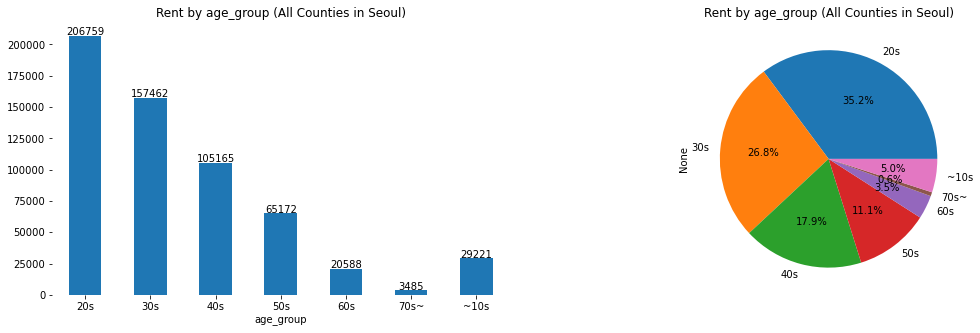

In [49]:
use_per_age = users.groupby('age_group').size()
# use_per_age = use_per_age.reindex(age_order)
print(use_per_age)

fig, axes = plt.subplots(1, 2, figsize=(18, 5))
ax = use_per_age.plot(kind='bar', title="Rent by age_group (All Counties in Seoul)", rot=0, ax=axes[0])#colors=['blue', 'orange', 'green', 'red', 'purple', 'brown', 'pink'])
for p in ax.patches:
    left, bottom, width, height = p.get_bbox().bounds
    ax.annotate("%d"%(height), (left+width/2, height+700), ha='center')
plt.sca(ax)
plt.box(False)
ax = use_per_age.div(use_per_age.sum()).plot(kind='pie', title="Rent by age_group (All Counties in Seoul)", autopct='%.1f%%', ax=axes[1])
plt.show()

age_group
20s     12663
30s     10462
40s      6779
50s      3631
60s      1518
70s~      161
~10s     1368
dtype: int64


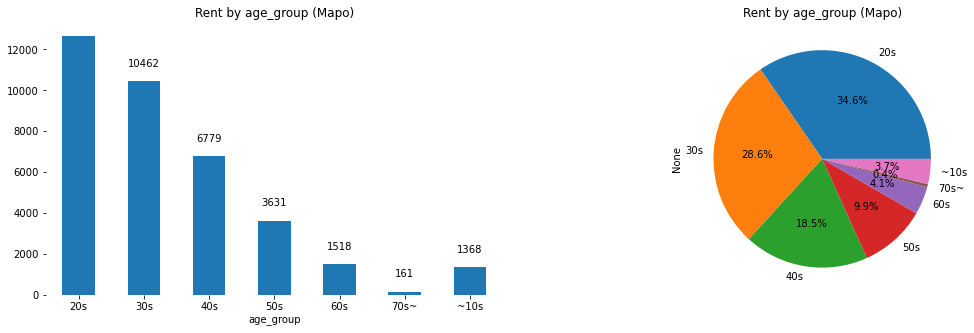

In [82]:
mapo_use_per_age = mapo_users.groupby('age_group').size()
# use_per_age = use_per_age.reindex(age_order)
print(mapo_use_per_age)

fig, axes = plt.subplots(1, 2, figsize=(18, 5))
ax = mapo_use_per_age.plot(kind='bar', title="Rent by age_group (Mapo)", rot=0, ax=axes[0])#colors=['blue', 'orange', 'green', 'red', 'purple', 'brown', 'pink'])
for p in ax.patches:
    left, bottom, width, height = p.get_bbox().bounds
    ax.annotate("%d"%(height), (left+width/2, height+700), ha='center')
plt.sca(ax)
plt.box(False)
ax = mapo_use_per_age.div(mapo_use_per_age.sum()).plot(kind='pie', title="Rent by age_group (Mapo)", autopct='%.1f%%', ax=axes[1])
plt.show()

In [51]:
comp = pd.DataFrame({'All Counties in Seoul' : [29221, 206759, 157462, 105165, 65172, 20588, 3485],
              'Mapo' : mapo_use_per_age},
              index = age_order)
comp = comp.div(comp.sum()) * 100
comp['diff'] = abs(comp['All Counties in Seoul'] - comp['Mapo'])
comp = comp.sort_values('diff')

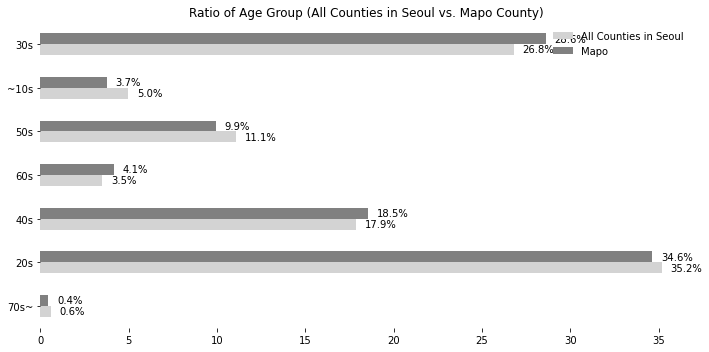

In [52]:
ax = comp[['All Counties in Seoul', 'Mapo']].plot(kind='barh', figsize=(10, 5), color=['lightgrey', 'grey'], 
                                                  title="Ratio of Age Group (All Counties in Seoul vs. Mapo County)")
for p in ax.patches: 
    x, y, width, height = p.get_bbox().bounds 
    ax.text(width+0.5, y+height/2, "%.1f%%"%(width), va='center')

plt.box(False)
plt.legend(frameon=False)
plt.tight_layout()
plt.show()

- Compared to all counties in Seoul, Mapo has similar usuage rates across all age groups.

## 3. User Groups by Station

In this part, let's try to find stations that answer the following questions:
- **Are there stations with a big difference in usage ratio between men and women?**
- **Are there stations that a certain age group is more frequently using?**


### 3.1. Men-Women Ratio by Station
If we could find some patterns of a specific group, such information can be utilized for many promotionl events. For example, if one is running for a mayoral or governor position and wants to attract voters from a specific group, he/she can go to the stations where that specific group of users are using bikes most frequently.

In [53]:
df_pivot = mapo_users.pivot_table(index="start_station_name", columns='sex', values='rent_cnt', aggfunc='sum', fill_value=0)
df_pivot = df_pivot.div(df_pivot.sum(axis=1), axis=0)
print(df_pivot.shape)
df_pivot.head()

(101, 2)


sex,F,M
start_station_name,,
(구)합정동 주민센터,0.487395,0.512605
DMC빌 앞,0.282828,0.717172
DMC산학협력연구센터 앞,0.326761,0.673239
DMC역 2번출구 옆,0.290000,0.710000
DMC역 9번출구 앞,0.240545,0.759455


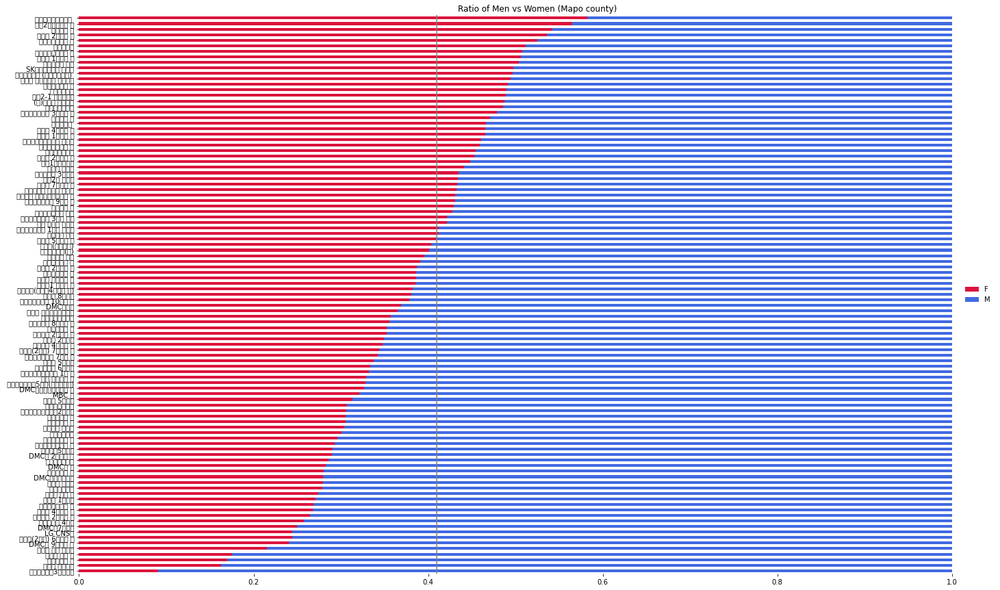

In [54]:
df_pivot.sort_values('F', inplace=True)

df_pivot.plot(kind='barh', stacked=True, figsize=(24, 15), title="Ratio of Men vs Women (Mapo county)", rot=0, color=sex_colors)
plt.box(False)
plt.legend(frameon=False, loc='center left', bbox_to_anchor=(0.96, 0.5))
plt.ylabel("")
plt.axvline(x=0.41, color='grey')
plt.show()

- In "2.1. Usage Comparison by Age" section, we observed that the men to women ratio is 59:41. The grey line in the middle is at 0.41, which is the standard that determines whether a station has more women or men.
    
- Stations with red bars greater than the grey line represent stations with higher women usage ratio and vice versa.

In [55]:
favor_f = df_pivot.loc[df_pivot['F'] - 0.41 > 0][['F']]
favor_f = favor_f-0.41
favor_f.rename(columns={'F': 'ratio'}, inplace=True)
favor_f['favor'] = 'F'
favor_m = df_pivot.loc[df_pivot['M'] - 0.59 > 0][['M']]
favor_m = -favor_m+0.59
favor_m.rename(columns={'M': 'ratio'}, inplace=True)
favor_m['favor'] = 'M'

favor = favor_f.append(favor_m)

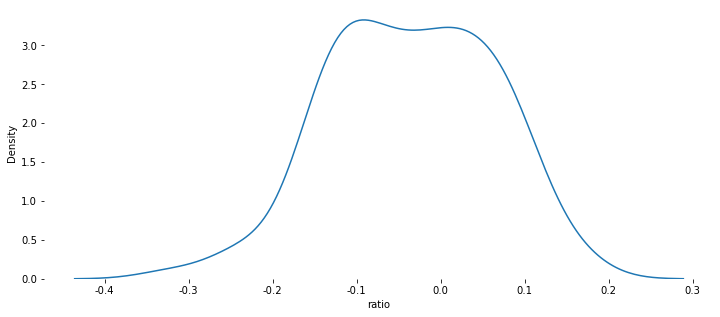

In [56]:
plt.figure(figsize=(12, 5))
sns.distplot(favor['ratio'], hist=False)
plt.box(False)
plt.show()

It's an overstatement to say that stations with slightly higher ratio than 0.41 have a difference in usage ratio between men and women. It'd be more reasonable to say that stations with 1.8 standard deviations away from 0.41 are the ones with a statistically significant difference in usage by sex.

In [57]:
std = favor['ratio'].std()
favor[favor['ratio'] < (-1.5)*std]

sex,ratio,favor
start_station_name,,
래미안신공덕3차아파트,-0.319091,M
대흥동 주민센터,-0.247209,M
현대벤처빌 앞,-0.239932,M
서강대 후문 옆,-0.234798,M
서강대 정문 건너편,-0.194897,M
DMC역 9번출구 앞,-0.169455,M
신촌역(2호선) 6번출구 옆,-0.165459,M
LG CNS앞,-0.165365,M
DMC역7번출구,-0.160000,M


In [58]:
favor[favor['ratio'] > 1.5*std]

sex,ratio,favor
start_station_name,,
망원2빗물펌프장 앞,0.154885,F
벽산상암스마트큐브,0.172456,F


These are the stations with 1.5 standard deviation away from 0.41 (value inside parentheses is the difference from 0.41 basis).
- Stations with statistically higher usage by Men:
    - 래미안신공덕3차아파트 (0.31)
    - 대흥동 주민센터 (0.24
    - LG CNS앞 (0.16)
- Stations with statistically higher usage by Women:
    - 망원2빗물펌프장 앞 (0.16)
    - 벽산상암스마트큐브 (0.17)

## 3.2. Ratio of Age Group by Station

Next, let's see if there are stations with statistically significant differences by age group.

In [59]:
mapo_users.head()

,start_time,start_hour,start_station_name,sex,age_group,rent_cnt,kcal,CO2,distance,duration,county,county_eng,lat,long
19741,2/1/2021,9,성산2교 사거리,F,20s,1.0,63.77,0.62,2683.98,17.0,마포구,Mapo,37.564697,126.912613
19742,2/1/2021,9,성산2교 사거리,M,20s,1.0,85.64,0.77,3327.11,20.0,마포구,Mapo,37.564697,126.912613
19743,2/1/2021,10,성산2교 사거리,F,30s,1.0,92.81,1.11,4782.97,31.0,마포구,Mapo,37.564697,126.912613
19744,2/1/2021,10,성산2교 사거리,F,~10s,1.0,27.85,0.18,781.30,6.0,마포구,Mapo,37.564697,126.912613
19745,2/1/2021,10,성산2교 사거리,M,40s,1.0,215.77,1.5,6486.55,29.0,마포구,Mapo,37.564697,126.912613


In [60]:
df_pivot = mapo_users.pivot_table(index="start_station_name", columns='age_group', values='rent_cnt', aggfunc='sum', fill_value=0)
df_pivot = df_pivot.div(df_pivot.sum(axis=1), axis=0)
print(df_pivot.shape)
df_pivot.head()

(101, 7)


age_group,20s,30s,40s,50s,60s,70s~,~10s
start_station_name,,,,,,,
(구)합정동 주민센터,0.357143,0.411765,0.147059,0.063025,0.008403,0.000000,0.012605
DMC빌 앞,0.333333,0.292929,0.313131,0.040404,0.020202,0.000000,0.000000
DMC산학협력연구센터 앞,0.194366,0.326761,0.264789,0.129577,0.039437,0.019718,0.025352
DMC역 2번출구 옆,0.250000,0.275000,0.260000,0.075000,0.060000,0.055000,0.025000
DMC역 9번출구 앞,0.307110,0.257186,0.228442,0.148260,0.042360,0.010590,0.006051


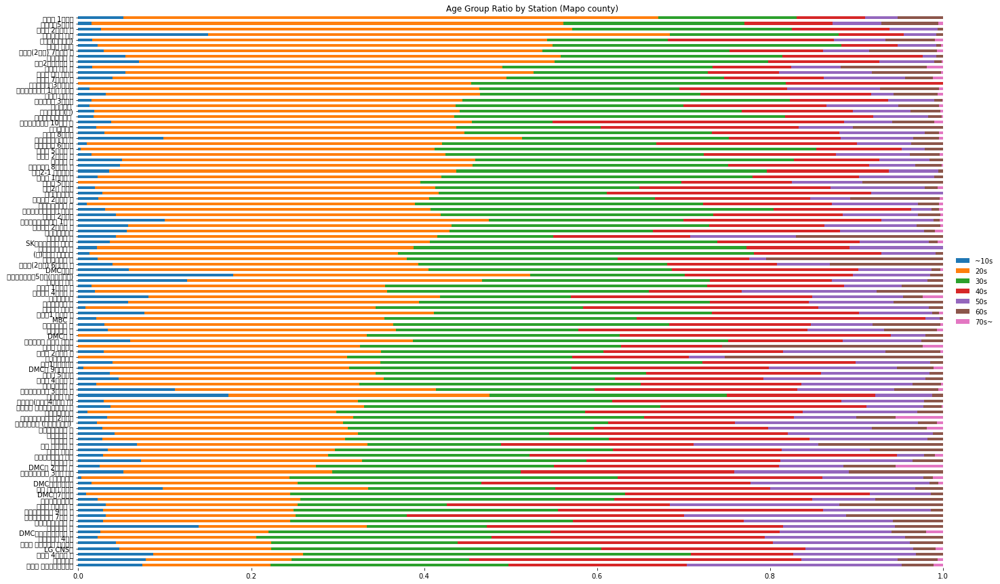

In [61]:
df_pivot.sort_values('20s', inplace=True)

df_pivot[age_order].plot(kind='barh', stacked=True, figsize=(24, 15), title="Age Group Ratio by Station (Mapo county)", rot=0)
plt.box(False)
plt.legend(frameon=False, loc='center left', bbox_to_anchor=(0.96, 0.5))
plt.ylabel("")
plt.show()

Stations are sorted in the descending order of age group 20s.
There seem to be differences in usage by age group.

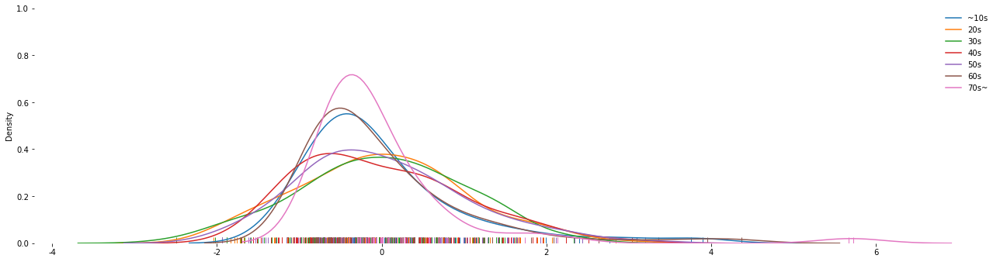

In [62]:
plt.figure(figsize=(18, 5))
for age in age_order:
    df_age = df_pivot[age]
    df_age = (df_age - df_age.mean()) / df_age.std()
    sns.distplot(df_age, hist=False, label=age, rug=True)
plt.legend(frameon=False)
plt.box(False)
plt.tight_layout()
plt.xlabel("")
plt.show()

The distribution plot above demonstrates the normalized distribution of all stations by age group.

- Age group 20s and 30s are most normally distributed. In other words, there exists deviations in these groups.
- Age group 10s and 60s have similar distribution.
- Age group 70s~ have the least deviation in ratio.
- Age group 70s~ have one value that exteremly high which indicate that there is a station that's more frequently used by age group 70s~ than others.

However, it's quiet difficult to find which stations are frequently used by which age group. Let's draw a map of stations used by each age group.

1. Each point represents a station.
2. The darker the color is, the more frequently the station is used.

In [63]:
df.head()

,start_time,start_station_id,start_station_name,end_time,end_station_id,end_station_name,duration,distance,start_hour,start_day,start_dayofweek,end_hour,county_x,county_eng_x,lat_x,long_x,county_y,county_eng_y,lat_y,long_y
0,2021-02-01 00:00:00,1514,강북구청 사거리 버스정류소 앞,2021-02-01 00:03:00,1554,번동사거리,2.0,736.02,0,1,0,0,강북구,Gangbuk,37.638805,127.028358,강북구,Gangbuk,37.635391,127.034554
1,2021-02-01 18:01:00,1514,강북구청 사거리 버스정류소 앞,2021-02-01 18:08:00,1554,번동사거리,7.0,779.26,18,1,0,18,강북구,Gangbuk,37.638805,127.028358,강북구,Gangbuk,37.635391,127.034554
2,2021-02-01 20:21:00,1514,강북구청 사거리 버스정류소 앞,2021-02-01 20:27:00,1554,번동사거리,5.0,0.00,20,1,0,20,강북구,Gangbuk,37.638805,127.028358,강북구,Gangbuk,37.635391,127.034554
3,2021-02-01 20:32:00,1514,강북구청 사거리 버스정류소 앞,2021-02-01 20:38:00,1554,번동사거리,5.0,736.02,20,1,0,20,강북구,Gangbuk,37.638805,127.028358,강북구,Gangbuk,37.635391,127.034554
4,2021-02-03 00:12:00,1514,강북구청 사거리 버스정류소 앞,2021-02-03 00:14:00,1554,번동사거리,2.0,628.99,0,3,2,0,강북구,Gangbuk,37.638805,127.028358,강북구,Gangbuk,37.635391,127.034554


In [64]:
rental_latlngs = df[['start_station_name', 'lat_x', 'long_x']].drop_duplicates().set_index('start_station_name')
rental_latlngs.index = rental_latlngs.index.str.strip()
df_pivot.index = df_pivot.index.str.strip()
df_pivot.columns = df_pivot.columns.astype('object')
df_pivot = df_pivot.join(rental_latlngs)

In [65]:
df_pivot.head()

,20s,30s,40s,50s,60s,70s~,~10s,lat_x,long_x
start_station_name,,,,,,,,,
(구)합정동 주민센터,0.357143,0.411765,0.147059,0.063025,0.008403,0.000000,0.012605,37.549561,126.905754
DMC빌 앞,0.333333,0.292929,0.313131,0.040404,0.020202,0.000000,0.000000,37.582657,126.885788
DMC산학협력연구센터 앞,0.194366,0.326761,0.264789,0.129577,0.039437,0.019718,0.025352,37.575802,126.890739
DMC역 2번출구 옆,0.250000,0.275000,0.260000,0.075000,0.060000,0.055000,0.025000,37.575069,126.899918
DMC역 9번출구 앞,0.307110,0.257186,0.228442,0.148260,0.042360,0.010590,0.006051,37.577469,126.897362


In [69]:
df_pivot.index.name = "start_station_name"

In [70]:
df_pivot.head()

,20s,30s,40s,50s,60s,70s~,~10s,lat_x,long_x
start_station_name,,,,,,,,,
(구)합정동 주민센터,0.357143,0.411765,0.147059,0.063025,0.008403,0.000000,0.012605,37.549561,126.905754
DMC빌 앞,0.333333,0.292929,0.313131,0.040404,0.020202,0.000000,0.000000,37.582657,126.885788
DMC산학협력연구센터 앞,0.194366,0.326761,0.264789,0.129577,0.039437,0.019718,0.025352,37.575802,126.890739
DMC역 2번출구 옆,0.250000,0.275000,0.260000,0.075000,0.060000,0.055000,0.025000,37.575069,126.899918
DMC역 9번출구 앞,0.307110,0.257186,0.228442,0.148260,0.042360,0.010590,0.006051,37.577469,126.897362


In [71]:
bike_map = folium.Map(location=[37.56261, 126.90761], zoom_start=14, zoom_control=False, height=800)
folium.TileLayer(tiles='cartodbpositron', overlay=True).add_to(bike_map)

# Add regional poligon
region = '마포구'
for region_data in geo_str['features']:
    if region_data['properties']['SIG_KOR_NM'] == region:
        polygon = np.array(region_data['geometry']['coordinates']).reshape(-1, 2).tolist()
        for coord in polygon:
            coord[0], coord[1] = coord[1], coord[0]
        folium.Polygon(polygon, color='darkgrey').add_to(bike_map)
        break

age_color = {age: color for age, color in zip(age_order, ['blue', 'darkorange', 'green', 'red', 'purple', 'brown', 'magenta'])}
dict_df_age = {}

for age in age_order:
    df_latlng_values = df_pivot.reset_index()[['lat_x', 'long_x', age, 'start_station_name']]
    
    # normalize data between 0 to 1.
    df_latlng_values[age] = (df_latlng_values[age] - df_latlng_values[age].min()) / (df_latlng_values[age].max() - df_latlng_values[age].min())
    
    # draw circle on each rental position.
    feature_group = folium.FeatureGroup(name=age, overlay=False)
    for idx, row in df_latlng_values.iterrows():
        folium.CircleMarker(row[['lat_x', 'long_x']],
                    fill=True, fill_color=age_color[age], fill_opacity=row[age],
                    tooltip="[%s]\n%.2f"%(row['start_station_name'], row[age]),
                    radius=5, opacity=0).add_to(feature_group)
    feature_group.add_to(bike_map)
    dict_df_age[age] = df_latlng_values[['start_station_name', age]].sort_values(age, ascending=False)

folium.LayerControl(collapsed=False).add_to(bike_map)

bike_map

### ~10s

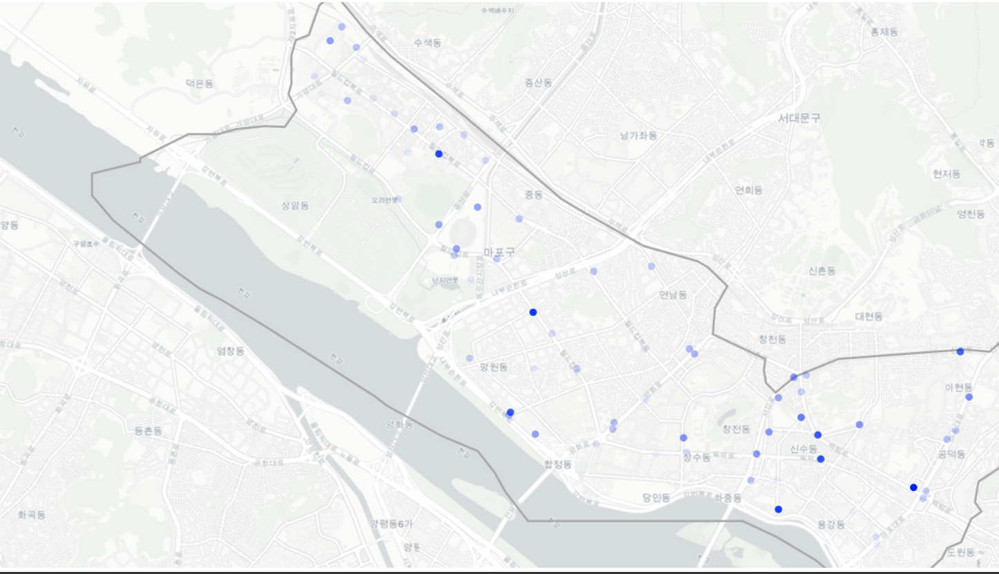

In [72]:
from IPython.display import Image
PATH = "C:/jiehwan94.github.io-master/assets/img/project/Seoul_Trip_3/"
Image(filename = PATH + "1.png", width=600, height=600)

For users in 10s age group, these are the stations with high usage rate:

1. 공덕역 2번 출구 (1.00)
2. 마포구청역 (0.90)
3. 마포 신수 공원 앞 (0.87)
4. 상암 월드컵파크 1단지 교차로 (0.84)

It does not seem to have a distinctive pattern.

### 20s

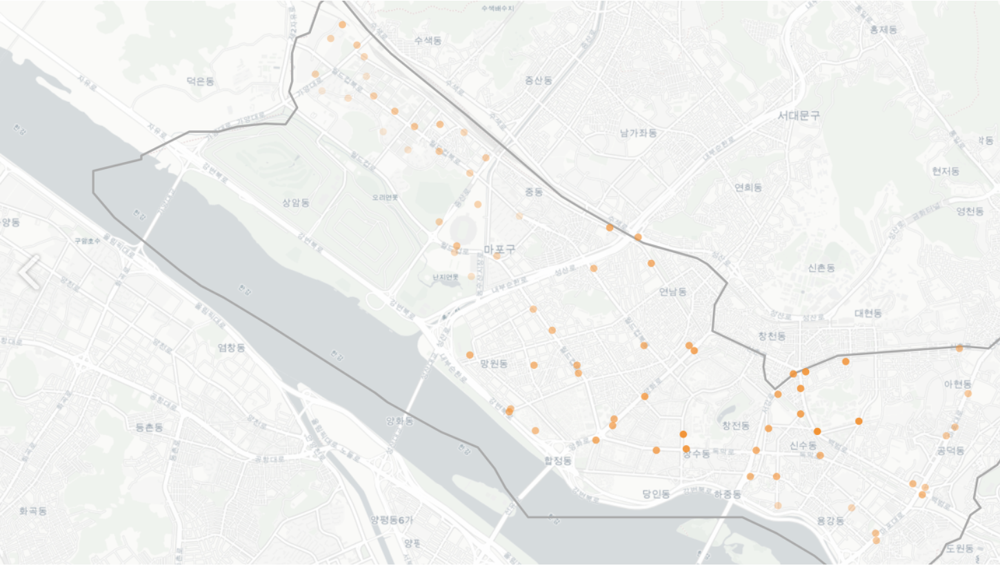

In [73]:
PATH = "C:/jiehwan94.github.io-master/assets/img/project/Seoul_Trip_3/"
Image(filename = PATH + "2.png", width=600, height=600)

For users in their 20s,they are using stations nearby college towns.

### 30s

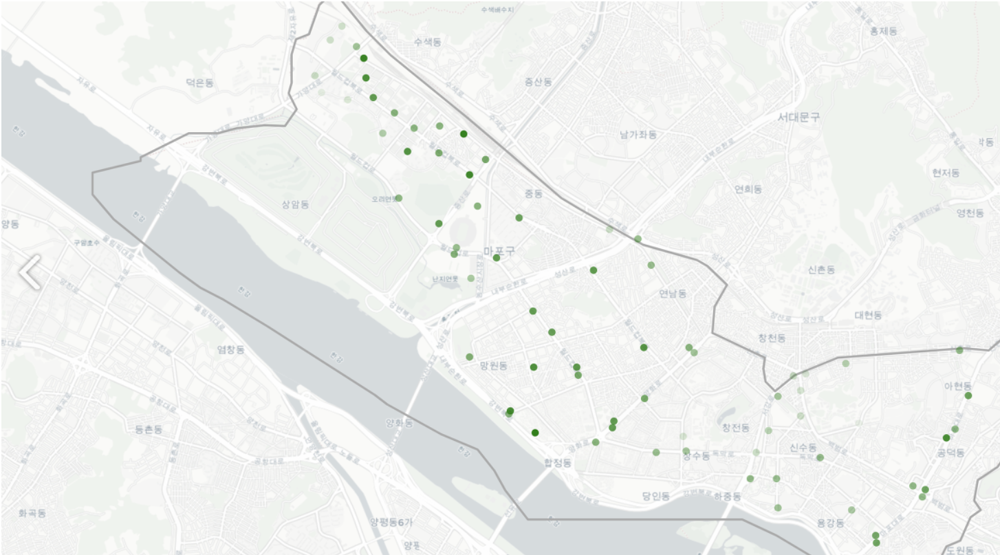

In [74]:
PATH = "C:/jiehwan94.github.io-master/assets/img/project/Seoul_Trip_3/"
Image(filename = PATH + "3.png", width=600, height=600)

For users in their 30s, they are more widely spread compared to those in 20s.

They seem to be using stations where most offices are located.

### 40s

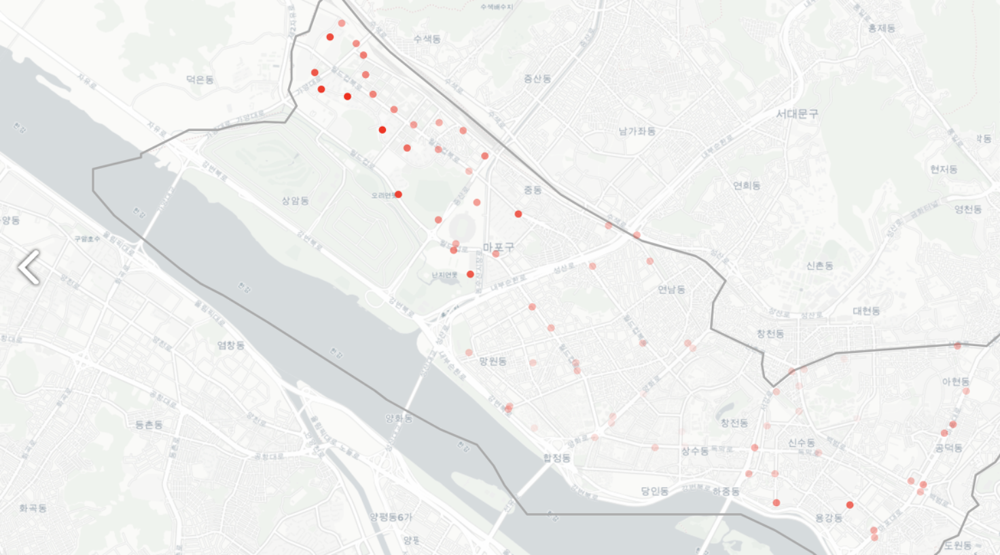

In [75]:
PATH = "C:/jiehwan94.github.io-master/assets/img/project/Seoul_Trip_3/"
Image(filename = PATH + "4.png", width=600, height=600)

For users in their 40s, they are heavily using stations nearby DMC area (upper left corner) which is quiet different from other age groups.

### 50s

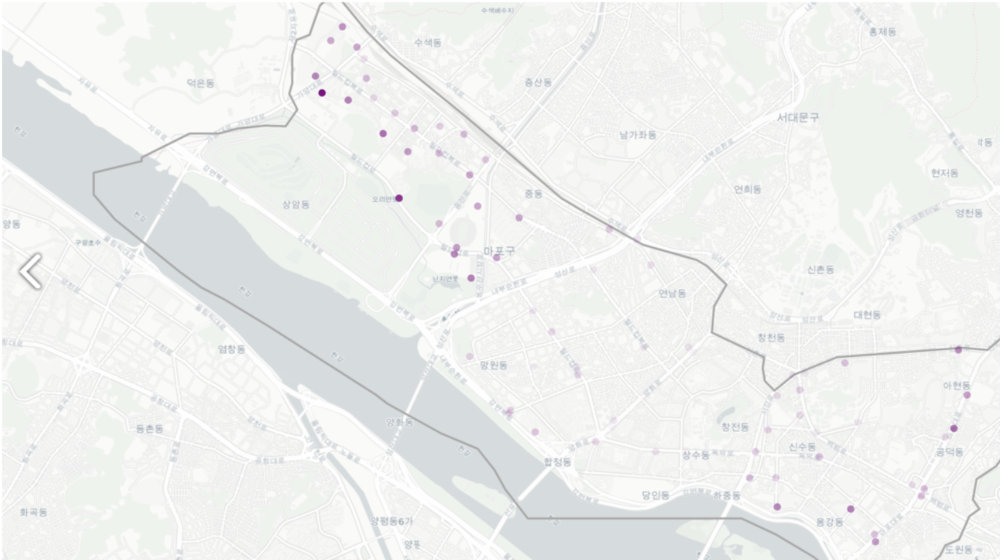

In [76]:
PATH = "C:/jiehwan94.github.io-master/assets/img/project/Seoul_Trip_3/"
Image(filename = PATH + "5.png", width=600, height=600)

For users in their 50s, they seem to have similar pattern with those in 40s.

### 60s

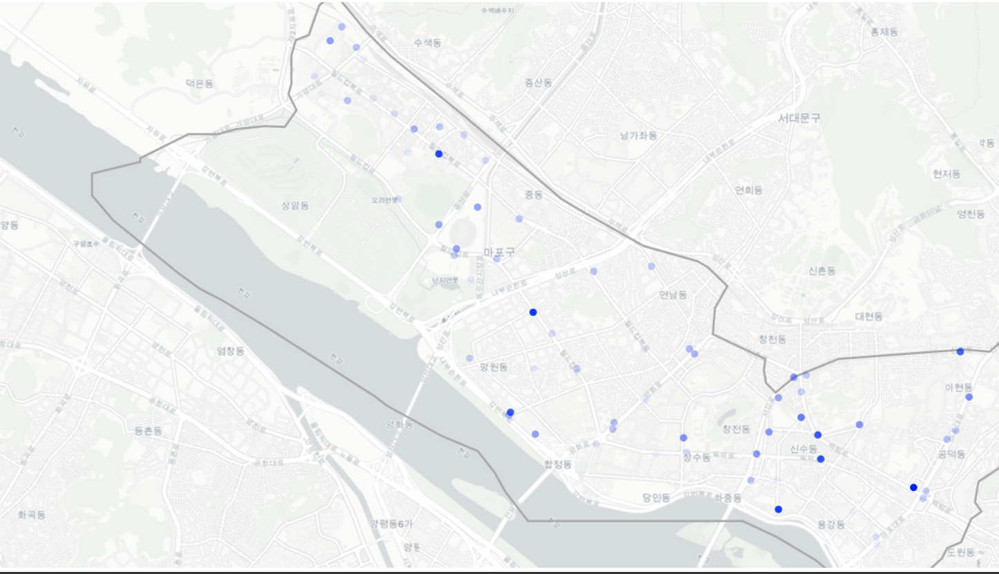

In [77]:
PATH = "C:/jiehwan94.github.io-master/assets/img/project/Seoul_Trip_3/"
Image(filename = PATH + "1.png", width=600, height=600)

For users in their 60s, they are using stations nearby Mapo County Office and Changcheon-dong, where 2 story houses are located (Just like city of New York, most people live in apartment in Seoul).

### 70s~

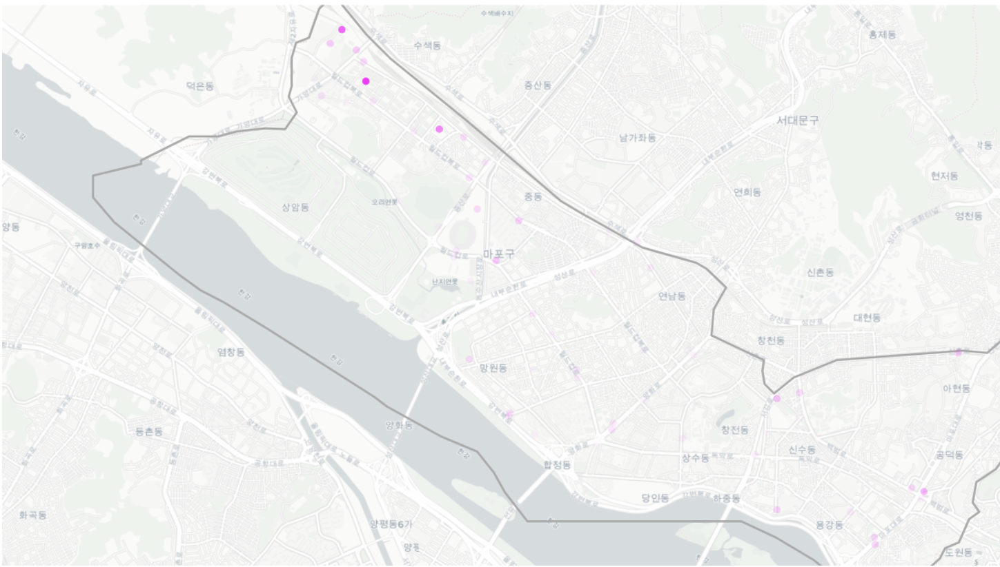

In [78]:
PATH = "C:/jiehwan94.github.io-master/assets/img/project/Seoul_Trip_3/"
Image(filename = PATH + "7.png", width=600, height=600)

For users in their 70s, they are using stations at a specific region in DMC.

## 4. Frequency of Trips between Two Stations

In this part, let's take a closer look at the trip route.

It'd have been better if we have access to the exact path that each trip took place, but we only have origin and destination information in our dataset. 

Given what we have, let's draw lines from origin to destination with the following rules:

1. Each **dot** indicates a station.
2. Each station's usage ratio (Rent + Return) is represented by **transparency**. The greater usage ratio, the thicker the line is.
3. Each trip from origin to destination is reperesented by **a line**.
4. For routes with relatively high frequency, we indicate those routes with **arrows** (because it's hard to interpret the map if we were to draw arrows for every trip).
5. We will looking at weekday trips only. (Excluding trips on weekends)
6. Assuming that trips have different patterns by different time of day, we will split the day into specific times and look for patterns.

In [79]:
from collections import namedtuple

def get_arrows(locations, color='blue', weight=1, size=6, n_arrows=3, some_map=None):
    
    '''
    Get a list of correctly placed and rotated 
    arrows/markers to be plotted
    
    Parameters
    locations : list of lists of lat lons that represent the 
                start and end of the line. 
                eg [[41.1132, -96.1993],[41.3810, -95.8021]]
    arrow_color : default is 'blue'
    size : default is 6
    n_arrows : number of arrows to create.  default is 3
    Return
    list of arrows/markers
    '''
    
    Point = namedtuple('Point', field_names=['lat', 'lon'])
    
    # creating point from our Point named tuple
    p1 = Point(locations[0][0], locations[0][1])
    p2 = Point(locations[1][0], locations[1][1])
    
    # getting the rotation needed for our marker.  
    # Subtracting 90 to account for the marker's orientation
    # of due East(get_bearing returns North)
    rotation = get_bearing(p1, p2) - 90
    
    # get an evenly space list of lats and lons for our arrows
    # note that I'm discarding the first and last for aesthetics
    # as I'm using markers to denote the start and end
    arrow_lats = np.linspace(p1.lat, p2.lat, n_arrows + 2)[1:n_arrows+1]
    arrow_lons = np.linspace(p1.lon, p2.lon, n_arrows + 2)[1:n_arrows+1]
    
    arrows = []
    
    #creating each "arrow" and appending them to our arrows list
    for points in zip(arrow_lats, arrow_lons):
        arrows.append(folium.RegularPolygonMarker(location=points, 
                      fill_color=color, number_of_sides=3, opacity=weight,
                      radius=size, rotation=rotation).add_to(some_map))
    return arrows

def get_bearing(p1, p2):
    
    '''
    Returns compass bearing from p1 to p2
    
    Parameters
    p1 : namedtuple with lat lon
    p2 : namedtuple with lat lon
    
    Return
    compass bearing of type float
    
    Notes
    Based on https://gist.github.com/jeromer/2005586
    '''
    
    long_diff = np.radians(p2.lon - p1.lon)
    
    lat1 = np.radians(p1.lat)
    lat2 = np.radians(p2.lat)
    
    x = np.sin(long_diff) * np.cos(lat2)
    y = (np.cos(lat1) * np.sin(lat2) 
        - (np.sin(lat1) * np.cos(lat2) 
        * np.cos(long_diff)))
    bearing = np.degrees(np.arctan2(x, y))
    
    # adjusting for compass bearing
    if bearing < 0:
        return bearing + 360
    return bearing

In [105]:
def draw_traffic(df, dayofweek, time, region, normalize=False, marker_on=False, heatmap=False, arrow=True):
    if dayofweek == "Weekday":
        _dayofweek = set(range(0,5))
    elif dayofweek == "Weekend":
        _dayofweek = set(range(5,7))
    else:
        print("dayofweek must be either Weekdays or Weekends")
        return -1
    
    df = df[df['start_dayofweek'].isin(_dayofweek)]
    df = df[df['start_hour'].isin(time)]
    
    # Traffic line
    by_rental = df.groupby(['lat_x', 'long_x', 'lat_y', 'long_y']).size()
    weights = by_rental.values.tolist()
    lat_lngs = by_rental.index.values.tolist()
    
    # Route Usage Distribution
    plt.figure(figsize=(24, 5))
    sns.distplot(np.array(weights).flatten(), rug=True, kde=False, bins=140)
    plt.title("Route Usage Distribution")
    plt.xlabel("# of Usage")
    plt.show()
    
    # - weight
    if normalize:
        weights = np.log(np.array(weights).flatten()) / np.log(np.array(weights).flatten()).max()
        weights = weights
        
        # - Specific Route Usage Distribution
        plt.figure(figsize=(24, 5))
        sns.distplot(np.array(weights).flatten(), rug=True, kde=False, bins=140)
        plt.title("Specific Route Usage Distribution")
        plt.xlabel("Usage Count (logged)")
        plt.show()
    else:
        weights = [weight / max(weights) for weight in weights]
        
    
    # - plot map first
    center = np.array(lat_lngs).mean(axis=0)[:2]
    bike_map = folium.Map(location=center, zoom_start=14, tiles='cartodbpositron', zoom_control=False)
    
    for line, weight in zip(lat_lngs, weights):
        # Add arrow
        if arrow and weight >= 0.3:
            # only >= 0.3
            arrows = get_arrows([line[:2], line[2:4]], weight=weight, size=5, n_arrows=3, some_map=bike_map)
            for arrow in arrows:
                arrow.add_to(bike_map)
        
        line = [(line[0], line[1]), (line[2], line[3])]
        folium.PolyLine(line, opacity=weight+0.05, weight=1.5).add_to(bike_map)
        
    
    # heatmap 
    if heatmap:
        for use, color in zip(["Rent", "Return"], ["red", "green"]):
            _df = df.groupby(['%sStation Latitude'%use, '%sStation Longitude'%use]).size()

            # Set weight to 0~1
            _df = _df / _df.max()

            points = _df.reset_index().values.tolist()

            folium.HeatMap(points, radius=15, ).add_to(bike_map)
            break
    
    #marker
    if marker_on:
        rentals = pd.DataFrame(data={
            "Rent": df.groupby(["lat_x", "long_x"]).size(),
            "Return": df.groupby(["lat_y", "long_y"]).size()
        }).fillna(0)
        
        rentals.index.names = ['lat_x','long_x']
        rentals.reset_index(inplace=True)
        rentals = rentals.merge(df.groupby(['lat_x', 'long_x', 'start_station_name']).size().reset_index().drop(columns=0),
                left_on=['lat_x', 'long_x'],
                right_on=['lat_x', 'long_x'])[['start_station_name', 'lat_x', 'long_x', 'Rent', 'Return']]
        rentals['Usage'] = rentals['Rent'] + rentals['Return']
        rentals['Ratio'] = rentals['Ratio'] / rentals['Ratio'].max()
        
        for idx, rental in rentals.iterrows():
            tooltip_text = "[%s]\nRent: %d\nReturn: %d" %(rental['start_station_name'], rental['Rent'], rental['Return'])
            folium.CircleMarker(rental[['lat_x', 'long_x']], 
                                fill=True, fill_color='blue', fill_opacity=rental['Ratio'],
                                radius=5, opacity=0, tooltip=tooltip_text).add_to(bike_map)
    
    # region poligon
    for region_data in geo_str['features']:
        if region_data['properties']['SIG_KOR_NM'] == region:
            polygon = np.array(region_data['geometry']['coordinates']).reshape(-1, 2).tolist()
            for coord in polygon:
                coord[0], coord[1] = coord[1], coord[0]
            folium.Polygon(polygon, color='darkgrey').add_to(bike_map)
            break
    
    # html save.
    if normalize:
        bike_map.save('map/%s-%s-%s-%s(normalized).html' %(region, dayofweek, time[0], time[-1]+1))
    else:
        bike_map.save('map/%s-%s-%s-%s.html' %(region, dayofweek, time[0], time[-1]+1))
    return bike_map

### 4.1. Commute to work (7am ~ 10am)

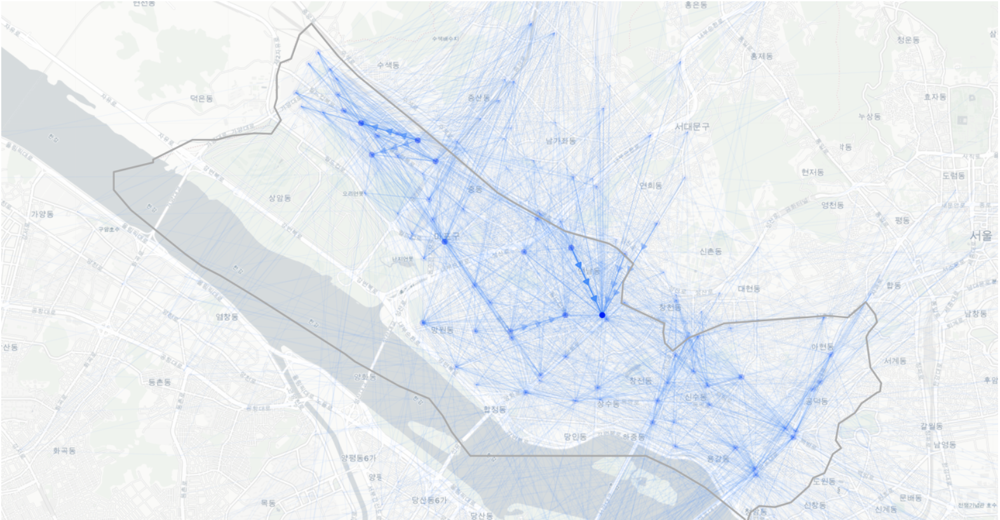

In [113]:
draw_traffic(mapo, "Weekday", list(range(7, 10)), "마포구", marker_on=True)

- **Most traffic at DMC and Hongik University 2 Exit"**
- These are the stations that people commute to work or school.

### 4.2. Afternoon (10am ~ 5pm)

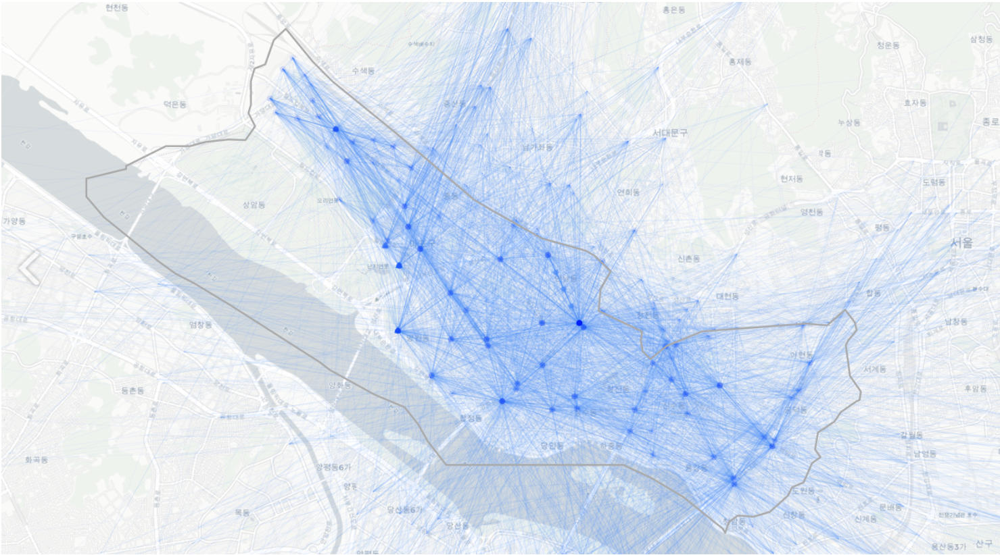

In [114]:
draw_traffic(mapo, "Weekday", list(range(10, 17)), "마포구", marker_on=True)

- More distributed traffic than 7am ~ 10am
- Stations at Hongik University still have a lot of traffic coming in which means that the bike operation management team has to move bikes from here to other stations to avoid shortage of bikes in certain stations. However, when it gets closer to 5pm when people start going home, they might need to have extra bikes at Hongik Univ. stations.

### 4.3. Commute back home (5pm ~ 8pm)

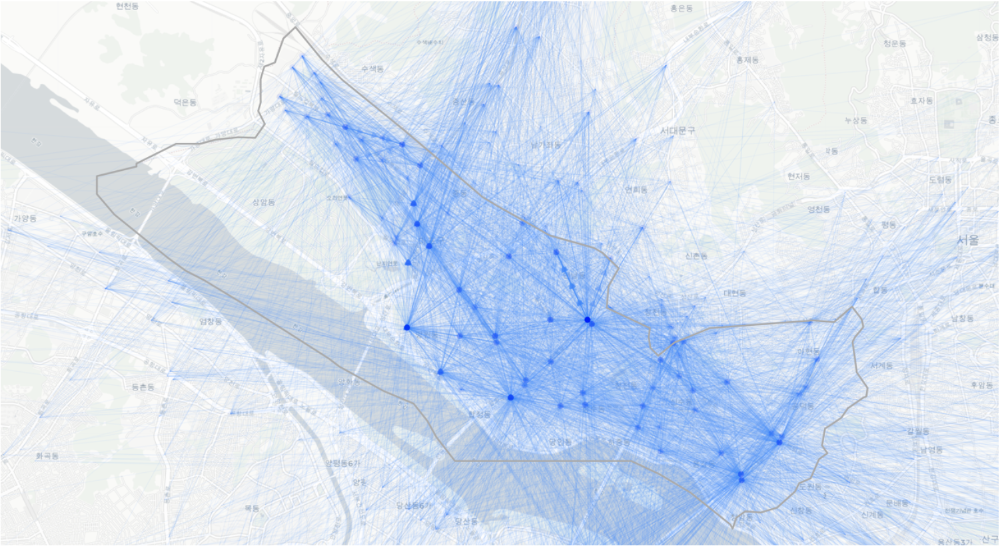

In [115]:
draw_traffic(mapo, "Weekday", list(range(17, 20)), "마포구", marker_on=True)

- As shown in the arrows, the very opposite happens when they are commuting back home.
- People are riding bikes to the Han River.

### 4.4. Night (8pm ~ 0 am)

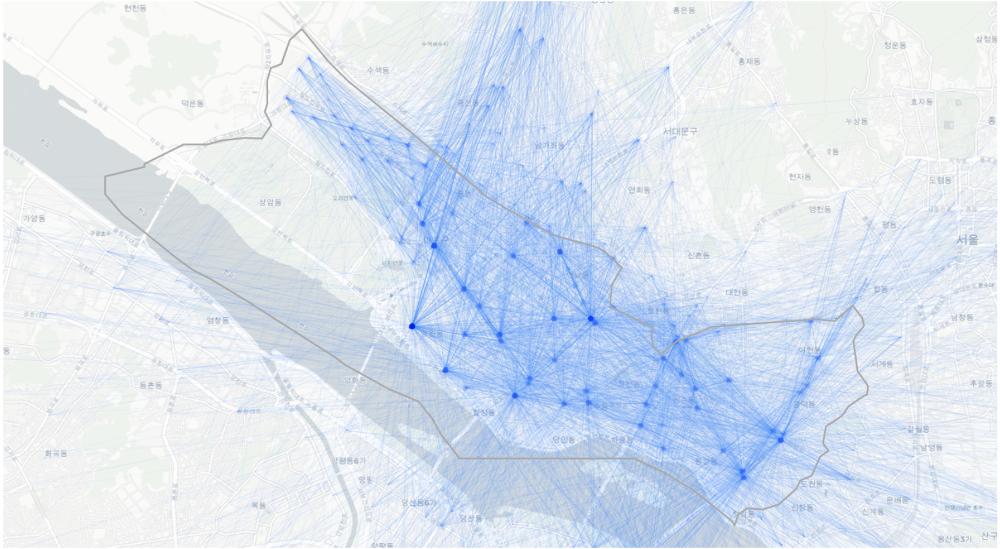

In [116]:
draw_traffic(mapo, "Weekday", list(range(20, 24)), "마포구", marker_on=True)

- Similar to 5pm ~ 8pm with relatively less traffic

## 5. Inflow/Outflow: Trips to and from Mapo County

With which county does Mapo county has most traffic?

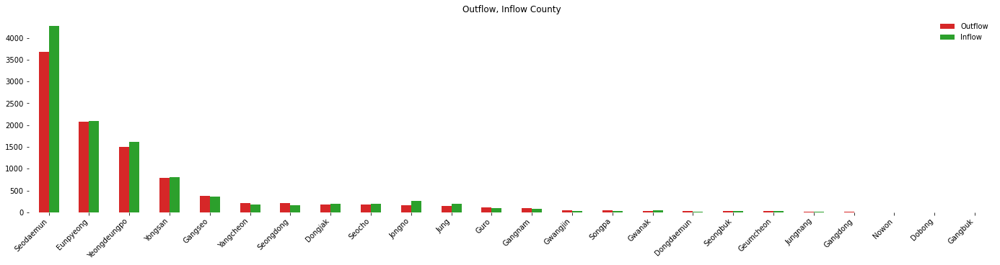

In [117]:
inout = pd.DataFrame([mapo['county_eng_y'].value_counts().drop("Mapo"),
                      mapo['county_eng_x'].value_counts().drop("Mapo")],
                    index=['Outflow', 'Inflow']).T
inout = inout.sort_values('Outflow', ascending=False)
inout.plot(kind='bar', figsize=(24, 5), title="Outflow, Inflow County", rot=0, color=['C3', 'C2'])
plt.box(False)
plt.legend(frameon=False)
plt.xticks(rotation=45, ha='right')
plt.show()

- Inflow-Outflow are in linear relationship. In other words, counties with high outflow have high inflow as well.
- As you might have guessed, there are many traffics to counties close to Mapo.
- Seodaemun > Eunpyeong > Yeongdeungpo > Yongsan

In [80]:
bike_map = folium.plugins.DualMap(location=[37.541, 126.986], zoom_start=10, tiles='cartodbpositron', zoom_control=False)
folium.Choropleth(geo_data=geo_str,
                  data=mapo['county_y'].value_counts().drop("마포구"),
                  key_on='feature.properties.SIG_KOR_NM', 
                  fill_color='Reds').add_to(bike_map.m1)
folium.Choropleth(geo_data=geo_str,
                  data=mapo['county_x'].value_counts().drop("마포구"),
                  key_on='feature.properties.SIG_KOR_NM', 
                  fill_color='Greens').add_to(bike_map.m2)
bike_map

## Summary

- Mapo has distinctive patterns in commute time.
- During 7am ~ 10am: inflow is approximately 30~35%
- During 5pm ~ 8pm: outflow is approximately 25~30%
- During commute time, there's highest traffic at stations in DMC and Hongik University.
- Traffics with other counties are mostly with nearby counties.